In [1]:
import warnings
warnings.filterwarnings('ignore')
import tensorflow
import cv2
import math

#mostly read file function
import numpy  
import pandas as pd
import glob
import numpy as np
import pickle
import joblib

from numpy import sqrt

from skimage.transform import pyramid_reduce, resize

#img function
import cv2 as cv
#thresholding filtering
import skimage.filters as filters

#ploting img or diagram function
import matplotlib.pyplot as plt

#train test split(split the dataset)
from sklearn.model_selection import train_test_split

#img preprocessing function
from sklearn.decomposition import PCA

#shuffle the list
from sklearn.utils import shuffle
                        
#to get the optimal parameter for the model
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import loguniform
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

#models
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC

#getting result tools
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import itertools
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.decomposition import PCA

from keras.callbacks import EarlyStopping, ModelCheckpoint

import tensorflow as tf
from tensorflow.keras import datasets, layers, models

import seaborn as sns
import matplotlib

%matplotlib inline

from keras.layers import Conv2D, MaxPooling2D, Dense, Dropout, Input, Flatten, Activation

#preprocessing part
from skimage.segmentation import clear_border
from skimage.measure import label,regionprops, perimeter
from skimage.morphology import ball, disk, binary_erosion, remove_small_objects, reconstruction, binary_closing, binary_opening
from skimage.filters import roberts, sobel
from scipy import ndimage as ndi

#plot 3d
from skimage import measure, feature
from mpl_toolkits.mplot3d.art3d import Poly3DCollection

In [2]:
#get all classes names
classes = ["Bengin","Malignant","Normal"]

#get all images location(total 1097 img)
img_list = sorted(glob.glob('Dataset/*/*.*'))
print('Total: ', len(img_list))

#get all images location(total 1097 img)
# train_list = sorted(glob.glob('Dataset/Train/*.*'))
train_list = sorted(glob.glob('Dataset/Train/*.*'))
print(len(train_list))

#get all images location(total 1097 img)
# test_list = sorted(glob.glob('Dataset/Test/*.*'))
test_list = sorted(glob.glob('Dataset/Test/*.*'))
print(len(test_list))

Total:  42
30
12


In [3]:
#plot image with title
def plot_img(images, titles, camp='gray', rows = 3, cols = 4, fontsize=50, top=10, right=10):
    plt.subplots_adjust(top=top,right=right)
    for i in range(len(images)):
        #(rows, columns, index)
#         fig, ax = subplots(figsize=(18, 2))
        plt.subplot(rows, cols, i+1)
        plt.imshow(images[i], cmap=camp)
        plt.title(titles[i], fontsize=fontsize)
        plt.xticks([])
        plt.yticks([])
        
#define a function to plot the images
def image_show(image, title, nrows=1, ncols=1, cmap='gray'):
    fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(4,4))
    ax.imshow(image, cmap=cmap)
    ax.set_title(title)
    ax.axis('off')
    return fig, ax

In [4]:
#Define variable to hold X & y
#create numpy array placeholder for pixels with 1 channel(grayscale)
IMG_SIZE = 512
CHANNEL = 1
#arg: (length of numpy set, height, width, color channel)
X = np.empty((len(img_list), IMG_SIZE, IMG_SIZE), dtype=np.uint8)

y = []

# convert images to numpy arrays
for i, img_path in enumerate(img_list):
    # load image
    img = cv.imread(img_path, cv.IMREAD_GRAYSCALE)
    img = cv.resize(img, (IMG_SIZE, IMG_SIZE))
    X[i] = img
    y.append("Bengin") if img_path.find(classes[0]) != -1 else (y.append(classes[1]) if img_path.find(classes[1]) != -1 else y.append(classes[2]))
    
y = pd.Series(y)

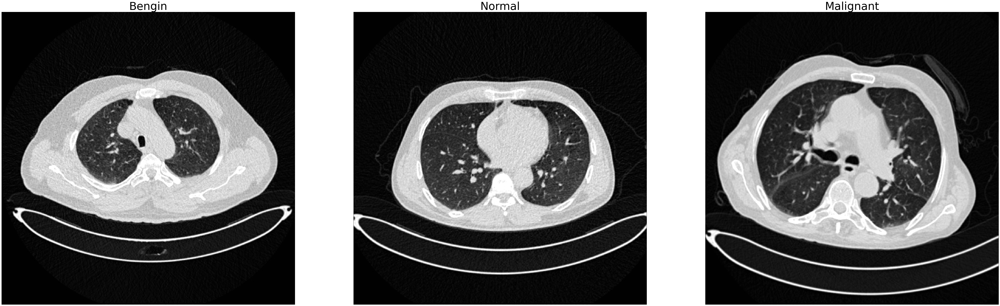

In [5]:
#show ori img
images = [X[0], X[10], X[24]]
titles = [y[0], y[10], y[24]]
plot_img(images, titles, rows = 2, cols = 3)

In [6]:
def get_segmented_lungs(im, num, save=False, plot=False, show_on_window=False, crop_percentage=0.05):
    #This funtion segments the lungs from the given 2D slice.
    
    crop = im.copy()
    if show_on_window:
        height,width=im.shape[:2]
        start_row,start_col=int(height*crop_percentage),int(width*crop_percentage)
        end_row,end_col=int(height*(1-crop_percentage)),int(width*(1-crop_percentage))
        crop=crop[start_row:end_row,start_col:end_col]
    else:
        if num == 161 or (num >= 173 and num <= 174) or (num == 758):
            height,width=im.shape[:2]
            start_row,start_col=int(height*0.20),int(width*0.20)
            end_row,end_col=int(height*0.80),int(width*0.80)
            crop=crop[start_row:end_row,start_col:end_col]
        elif num >= 756 and num <= 767:
            #Step 1: Crop the image 
            height,width=im.shape[:2]
            start_row,start_col=int(height*0),int(width*0)
            end_row,end_col=int(height*1),int(width*1)
            crop=crop[start_row:end_row,start_col:end_col]
        elif num == 1320 or num == 1219 or (num >= 712 and num <= 767) or (num >= 779 and num <= 799) or (num >= 688 and num <= 699) or (num >= 648 and num <= 664) or (num >= 225 and num <= 234):
            #Step 1: Crop the image 
            height,width=im.shape[:2]
            start_row,start_col=int(height*0.03),int(width*0.03)
            end_row,end_col=int(height*0.97),int(width*0.97)
            crop=crop[start_row:end_row,start_col:end_col]
        else:
            #Step 1: Crop the image 
            height,width=im.shape[:2]
            start_row,start_col=int(height*0.12),int(width*0.12)
            end_row,end_col=int(height*0.88),int(width*0.88)
            crop=crop[start_row:end_row,start_col:end_col]
        
    #Step 2: Convert into a binary image. 
    ret,binary = cv.threshold(crop,140,255,cv.THRESH_BINARY_INV)
    
    #Step 3: Remove the blobs connected to the border of the image.
    cleared = clear_border(binary) 
    
    #Step 4: Closure operation with a disk of radius 10. This operation is 
    #to keep nodules attached to the lung wall.
    selem = disk(2)
    closing = binary_closing(cleared, selem)
        
    #Step 5: Label the image.
    label_image = label(closing)
    
    #Step 6: Keep the labels with 2 largest areas.
    areas = [r.area for r in regionprops(label_image)]
    areas.sort()
    if len(areas) > 2:
        for region in regionprops(label_image):
            if region.area < areas[-2]:
                for coordinates in region.coords:                
                       label_image[coordinates[0], coordinates[1]] = 0
    segmented_area = label_image > 0
        
    #Step 7: Erosion operation with a disk of radius 2. This operation is 
    #seperate the lung nodules attached to the blood vessels.
    selem = disk(2)
    erosion = binary_erosion(segmented_area, selem) 
        
    #     Step 4: Closure operation with a disk of radius 10. This operation is 
    #     to keep nodules attached to the lung wall.
    selem = disk(10)
    closing2 = binary_closing(erosion, selem)    
    
    #Step 8: Fill in the small holes inside the binary mask of lungs.
    edges = roberts(closing2)
    fill_holes = ndi.binary_fill_holes(edges)
        
    superimpose = crop.copy()
    #Step 9: Superimpose叠加 the binary mask on the input image.
    get_high_vals = fill_holes == 0
    superimpose[get_high_vals] = 0

    superimpose = cv.resize(superimpose, (512, 512))    
    
    if show_on_window:
        directory1 = 'result/'
        directory2 = '.jpg'
        images = [im, crop, binary, cleared, closing, segmented_area, erosion, closing2, fill_holes, superimpose]
        titles = ['0_original_image', '1_cropped_image', '2_binary_image', '3_remove_blobs', '4_closure', '5_roi', '6_erosion', '7_closure', '8_fill_hole', '9_result']
        for i, title in enumerate(titles):
            filename = directory1 + title + directory2
            try:
                cv.imwrite(filename, images[i])
            except:
                indices = images[i].astype(np.uint8)  #convert to an unsigned byte
                indices*=255
                cv.imwrite(filename, indices)
    else:
        #flip vertically
        directory1 = 'preprocessing/pre1/'
        directory2 = '.jpg'
        images = [crop, binary, cleared, label_image, superimpose]
        titles = ['cropped_image', 'binary_image', 'remove_blobs', 'label', 'result']

        if save:
            for y in range(5):
                filename = directory1 + str(y+1) + titles[y] + '/' + titles[y] + str(num+1) + directory2
                cv.imwrite(filename, images[y])

    images = [im, crop, binary, cleared, closing, label_image, segmented_area, erosion, closing2, fill_holes, superimpose]
    
    if plot:
        titles = ['Original Image', 
                 'Step 1: Cropped Image', 
                 'Step 2: Binary image', 
                 'Step 3: Remove blobs', 
                 'Step 4: Closure', 
                 'Step 5: Label', 
                 'Step 6: Region On Interest',
                 'Step 7: Erosion',
                 'Step 8: Closure', 
                 'Step 9: Fill Holes',
                 'Step 10: Result']
        plot_img(images, titles, camp=plt.cm.bone, rows = 3, cols = 4, fontsize= 50)
    
#     if show_on_window:
#         directory1 = 'result/'
#         directory2 = '.jpg'
#         titles = ['0_original_image', '1_cropped_image', '2_binary_image', '3_remove_blobs', '4_closure', '5_roi', '6_erosion', '7_fill_hole', '8_result']
#         for i, title in enumerate(titles):
#             filename = directory1 + title + directory2
#             try:
#                 cv.imwrite(filename, images[i])
#             except:
#                 indices = images[i].astype(np.uint8)  #convert to an unsigned byte
#                 indices*=255
#                 cv.imwrite(filename, indices)
    
    return superimpose

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

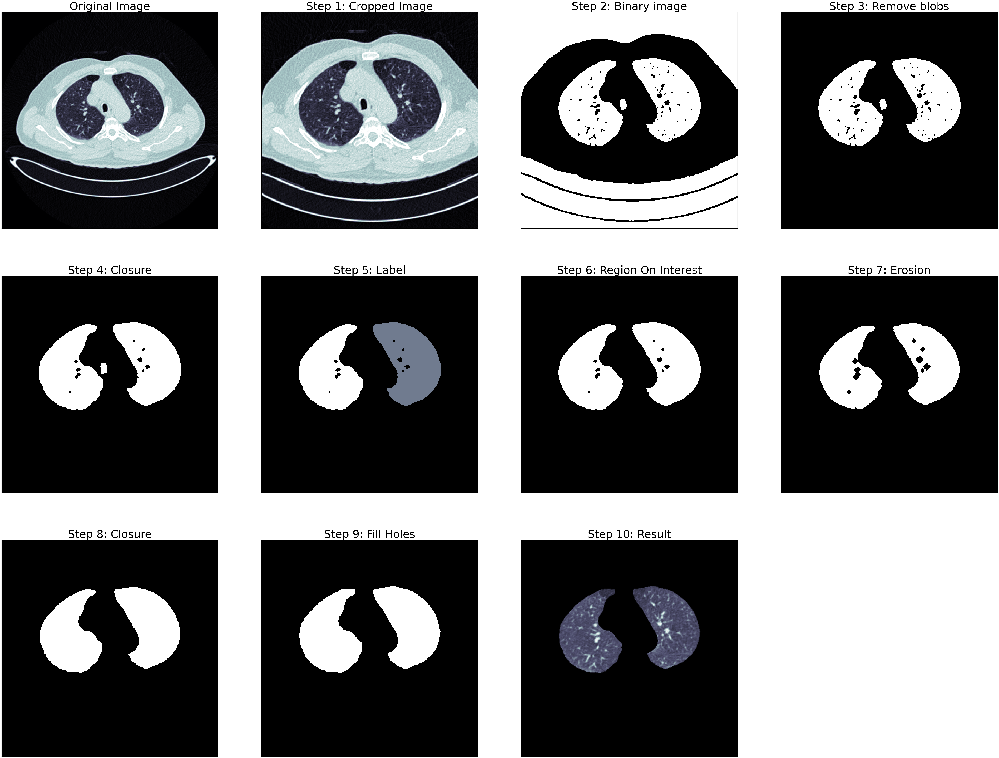

In [7]:
numOfImg = 1
test = X[numOfImg].copy()
get_segmented_lungs(test, numOfImg, plot = True, show_on_window=True, crop_percentage=0.12)

In [8]:
#Apply to all images
X_segmented = np.empty((len(img_list), IMG_SIZE, IMG_SIZE), dtype=np.uint8)

for i, img in enumerate(X):
    im = img.copy()
    X_segmented[i] = get_segmented_lungs(im, i)

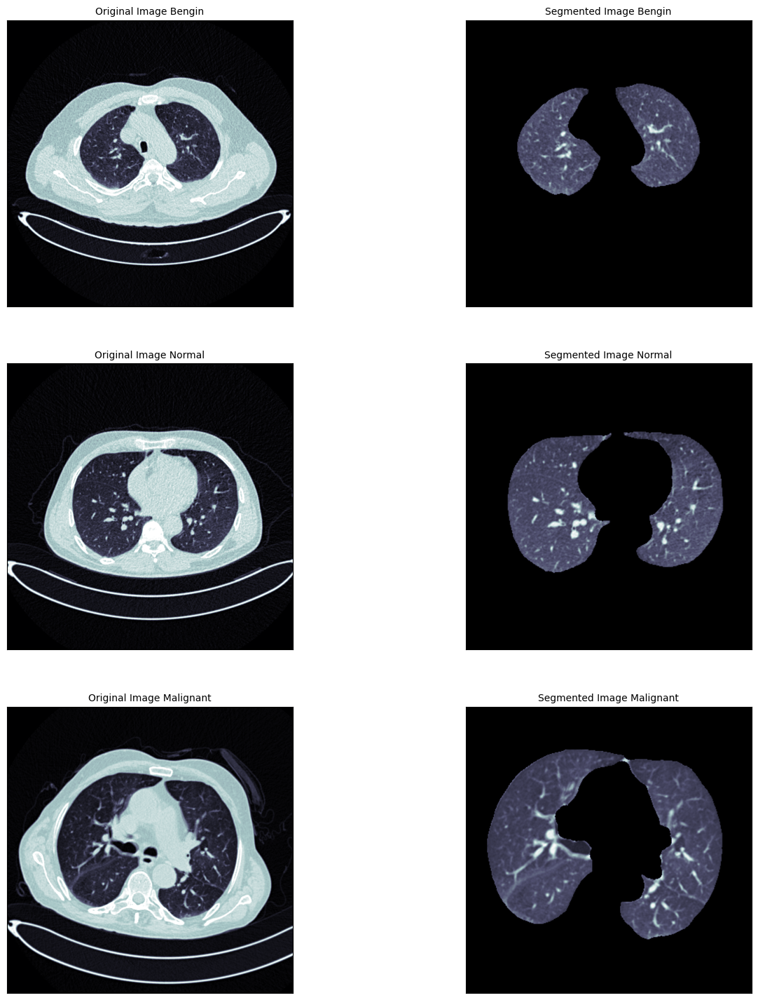

In [9]:
#show the changes of images
images = [X[0], X_segmented[0],
          X[10], X_segmented[10],
          X[24], X_segmented[24]]
titles = ['Original Image ' + y[0], 'Segmented Image ' + y[0], 
         'Original Image ' + y[10], 'Segmented Image ' + y[10], 
         'Original Image ' + y[24], 'Segmented Image ' + y[24]]
plot_img(images, titles, camp=plt.cm.bone, rows = 3, cols = 2, fontsize=10, top=3, right=2)

In [10]:
#define function to get the nodules
def get_nodules_lungs(im, plot=False):
    
    #Step 1: Get Nodules in binary
    binary = im < 140
    
    get_high_vals = binary == 0
    
    nodules = im.copy()
    
    nodules[nodules < 140] = 0
    
    if plot == True:
        images = [im, binary, nodules]
        titles = ['Segmented Image', 'Binary Nodules Image', 'Nodules Image']
        plot_img(images, titles, rows = 1, cols = 3, fontsize= 10)
        
    return nodules

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

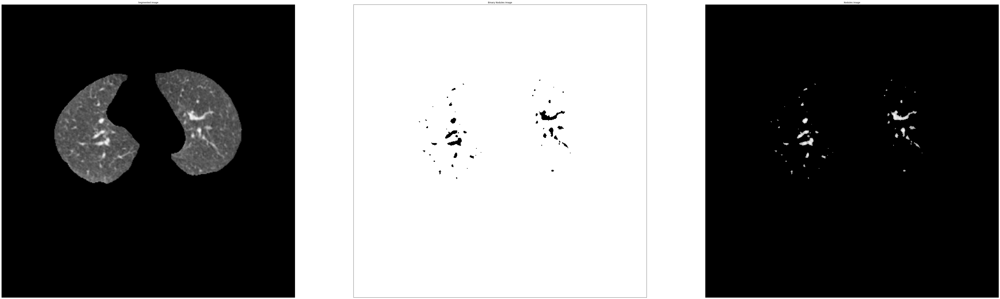

In [11]:
test = X_segmented[0].copy()
get_nodules_lungs(test, True)

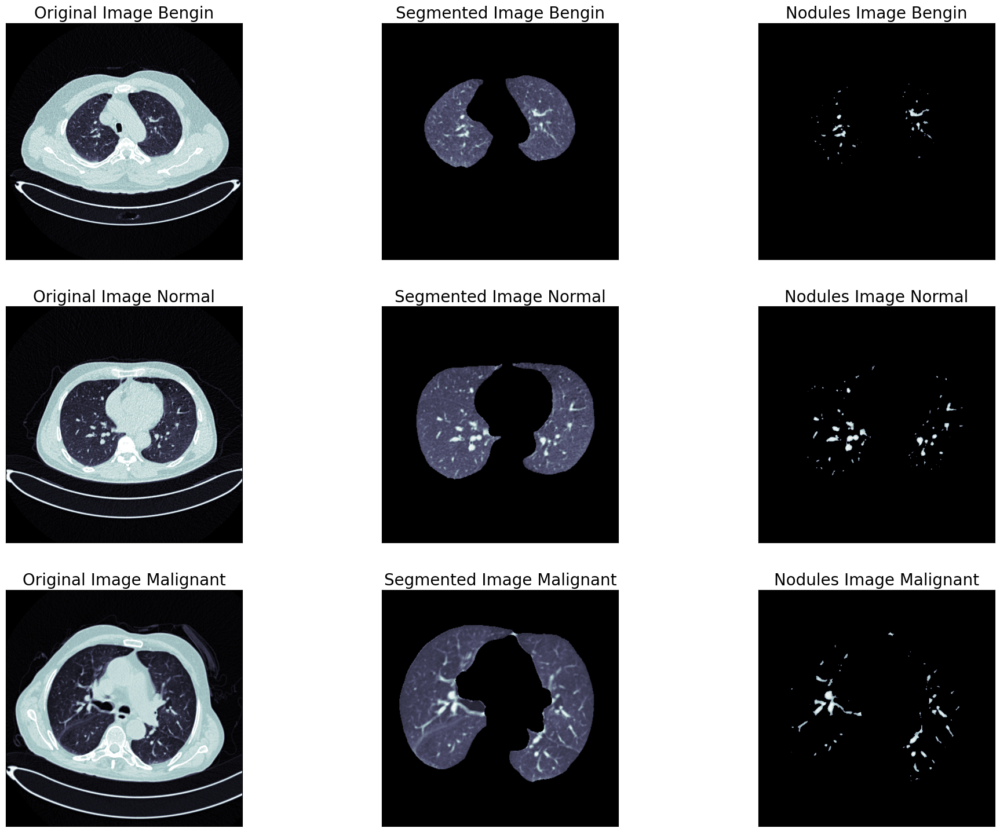

In [12]:
X_nodules = np.empty((len(img_list), IMG_SIZE, IMG_SIZE), dtype=np.uint8)

for i, img in enumerate(X_segmented):
    im = img.copy()
    X_nodules[i] = get_nodules_lungs(im)
    
images = [X[0], X_segmented[0], X_nodules[0],
          X[10], X_segmented[10], X_nodules[10],
          X[24], X_segmented[24], X_nodules[24]]
titles = ['Original Image ' + y[0], 'Segmented Image ' + y[0], 'Nodules Image ' + y[0],
         'Original Image ' + y[10], 'Segmented Image ' + y[10], 'Nodules Image ' + y[10], 
         'Original Image ' + y[24], 'Segmented Image ' + y[24], 'Nodules Image ' + y[24]]
plot_img(images, titles, camp=plt.cm.bone, rows = 3, cols = 3, fontsize= 20, top=3, right=3)

In [13]:
# method 1: Remove based on the region properties
selem = ball(2)
binary = binary_closing(X_nodules, selem)

X_nodules_further = X_nodules.copy()

label_scan = label(binary)

areas = [r.area for r in regionprops(label_scan)]
areas.sort()

for r in regionprops(label_scan):
    max_x, max_y, max_z = 0, 0, 0
    min_x, min_y, min_z = 2000, 2000, 2000
    
    for c in r.coords:
        max_z = max(c[0], max_z)
        max_y = max(c[1], max_y)
        max_x = max(c[2], max_x)
        
        min_z = min(c[0], min_z)
        min_y = min(c[1], min_y)
        min_x = min(c[2], min_x)
    if (min_z == max_z or min_y == max_y or min_x == max_x or r.area > areas[-3]):
        for c in r.coords:
            X_nodules_further[c[0], c[1], c[2]] = 0
    else:
        index = (max((max_x - min_x), (max_y - min_y), (max_z - min_z))) / (min((max_x - min_x), (max_y - min_y) , (max_z - min_z)))

In [14]:
# method 2: Using Opening method to remove
selem = ball(2)
X_nodules_opening = binary_closing(X_nodules, selem)

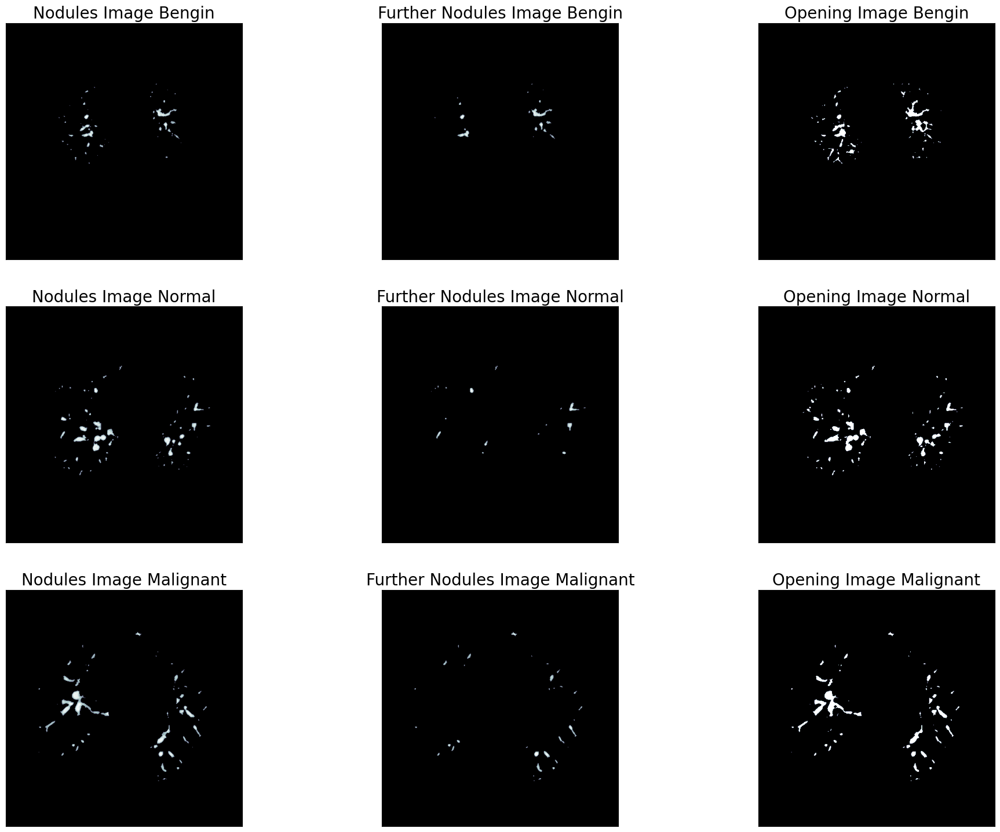

In [15]:
images = [X_nodules[0], X_nodules_further[0], X_nodules_opening[0],
          X_nodules[10], X_nodules_further[10], X_nodules_opening[10],
          X_nodules[24], X_nodules_further[24], X_nodules_opening[24]]
titles = ['Nodules Image ' + y[0], 'Further Nodules Image ' + y[0], 'Opening Image ' + y[0],
         'Nodules Image ' + y[10],  'Further Nodules Image ' + y[10], 'Opening Image ' + y[10],
         'Nodules Image ' + y[24], 'Further Nodules Image ' + y[24], 'Opening Image ' + y[24]]
plot_img(images, titles, camp=plt.cm.bone, rows = 3, cols = 3, fontsize= 20, top=3, right=3)

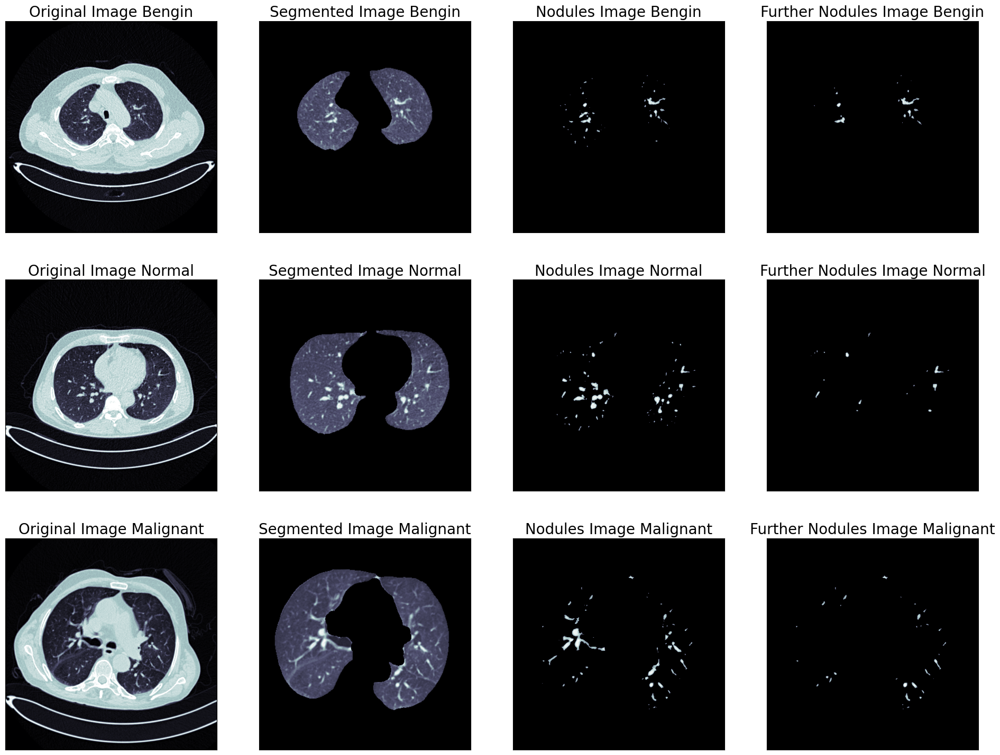

In [16]:
images = [X[0], X_segmented[0], X_nodules[0], X_nodules_further[0], 
          X[10], X_segmented[10], X_nodules[10], X_nodules_further[10], 
          X[24], X_segmented[24], X_nodules[24], X_nodules_further[24]]
titles = ['Original Image ' + y[0], 'Segmented Image ' + y[0], 'Nodules Image ' + y[0], 'Further Nodules Image ' + y[0],
         'Original Image ' + y[10], 'Segmented Image ' + y[10], 'Nodules Image ' + y[10],  'Further Nodules Image ' + y[10],
         'Original Image ' + y[24], 'Segmented Image ' + y[24], 'Nodules Image ' + y[24], 'Further Nodules Image ' + y[24]]
plot_img(images, titles, camp=plt.cm.bone, rows = 3, cols = 4, fontsize= 20, top=3, right=3)

In [17]:
#Define variable to hold X & y
#create numpy array placeholder for pixels with 1 channel(grayscale)
IMG_SIZE = 512
# CHANNEL = 1
#arg: (length of numpy set, height, width, color channel)
X_segmented_fft = np.empty((len(img_list), IMG_SIZE, IMG_SIZE), dtype=np.uint8)
X_segmented_fft_imaginer = np.empty((len(img_list), IMG_SIZE, IMG_SIZE), dtype=np.uint8)
X_segmented_fft_abs = np.empty((len(img_list), IMG_SIZE, IMG_SIZE), dtype=np.uint8)

X_nodules_fft = np.empty((len(img_list), IMG_SIZE, IMG_SIZE), dtype=np.uint8)
X_nodules_fft_imaginer = np.empty((len(img_list), IMG_SIZE, IMG_SIZE), dtype=np.uint8)
X_nodules_fft_abs = np.empty((len(img_list), IMG_SIZE, IMG_SIZE), dtype=np.uint8)

X_nodules_further_fft = np.empty((len(img_list), IMG_SIZE, IMG_SIZE), dtype=np.uint8)
X_nodules_further_fft_imaginer = np.empty((len(img_list), IMG_SIZE, IMG_SIZE), dtype=np.uint8)
X_nodules_further_fft_abs = np.empty((len(img_list), IMG_SIZE, IMG_SIZE), dtype=np.uint8)

X_nodules_opening_fft = np.empty((len(img_list), IMG_SIZE, IMG_SIZE), dtype=np.uint8)
X_nodules_opening_fft_imaginer = np.empty((len(img_list), IMG_SIZE, IMG_SIZE), dtype=np.uint8)
X_nodules_opening_fft_abs = np.empty((len(img_list), IMG_SIZE, IMG_SIZE), dtype=np.uint8)

index = range(42)

for i, img_segmented,img_nodules, img_nodules_further,img_nodules_opening in zip(index, X_segmented, X_nodules, X_nodules_further, X_nodules_opening):
    img_segmented = np.fft.fft2(img_segmented)
    img_nodules = np.fft.fft2(img_nodules)
    img_nodules_further = np.fft.fft2(img_nodules_further)
    img_nodules_opening = np.fft.fft2(img_nodules_opening)
    
    X_segmented_fft[i] = img_segmented
    X_nodules_fft[i] = img_nodules
    X_nodules_further_fft[i] = img_nodules_further
    X_nodules_opening_fft[i] = img_nodules_opening
    
    
    X_segmented_fft_imaginer[i] = np.imag(img_segmented)
    X_nodules_fft_imaginer[i] = np.imag(img_nodules)
    X_nodules_further_fft_imaginer[i] = np.imag(img_nodules_further)
    X_nodules_opening_fft_imaginer[i] = np.imag(img_nodules_opening)
    
    X_segmented_fft_abs[i] = np.abs(img_segmented)
    X_nodules_fft_abs[i] = np.abs(img_nodules)
    X_nodules_further_fft_abs[i] = np.abs(img_nodules_further)
    X_nodules_opening_fft_abs[i] = np.abs(img_nodules_opening)

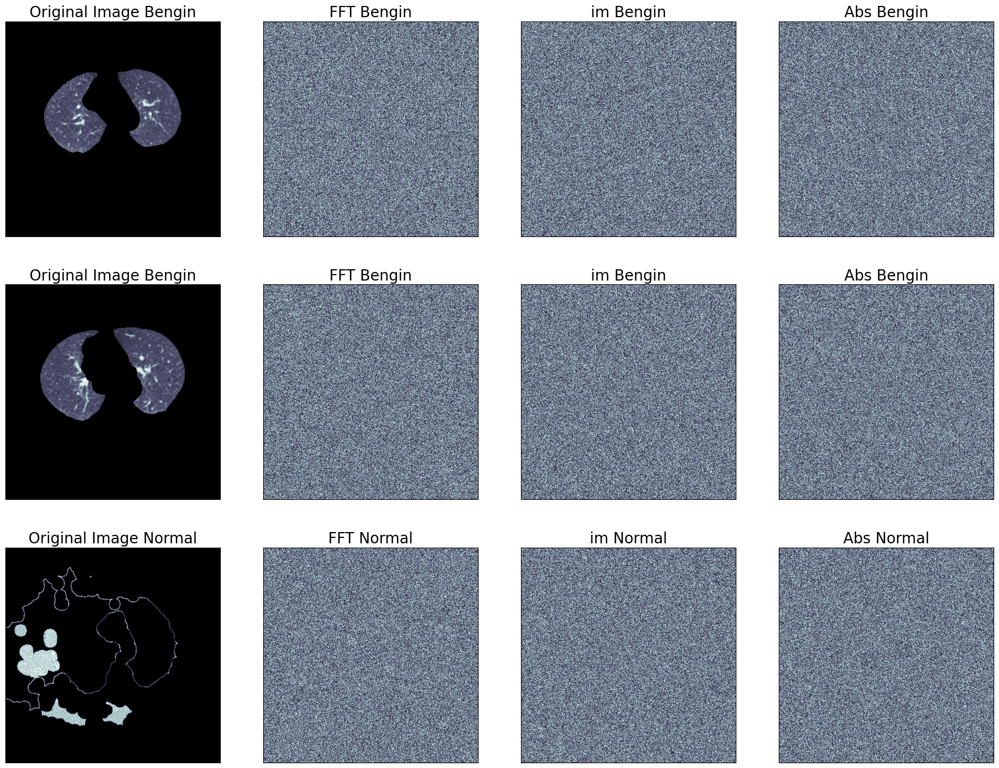

In [18]:
images = [X_segmented[0], X_segmented_fft[0], X_segmented_fft_imaginer[0], X_segmented_fft_abs[0], 
          X_segmented[15], X_segmented_fft[15], X_segmented_fft_imaginer[15], X_segmented_fft_abs[15], 
          X_segmented[34], X_segmented_fft[34], X_segmented_fft_imaginer[34], X_segmented_fft_abs[34]]
titles = ['Original Image ' + y[0], 'FFT ' + y[0], 'im ' + y[0], 'Abs ' + y[0],
         'Original Image ' + y[15], 'FFT ' + y[15], 'im ' + y[15],  'Abs ' + y[15],
         'Original Image ' + y[34], 'FFT ' + y[34], 'im ' + y[34], 'Abs ' + y[34]]
plot_img(images, titles, camp=plt.cm.bone, rows = 3, cols = 4, fontsize= 20, top=3, right=3)

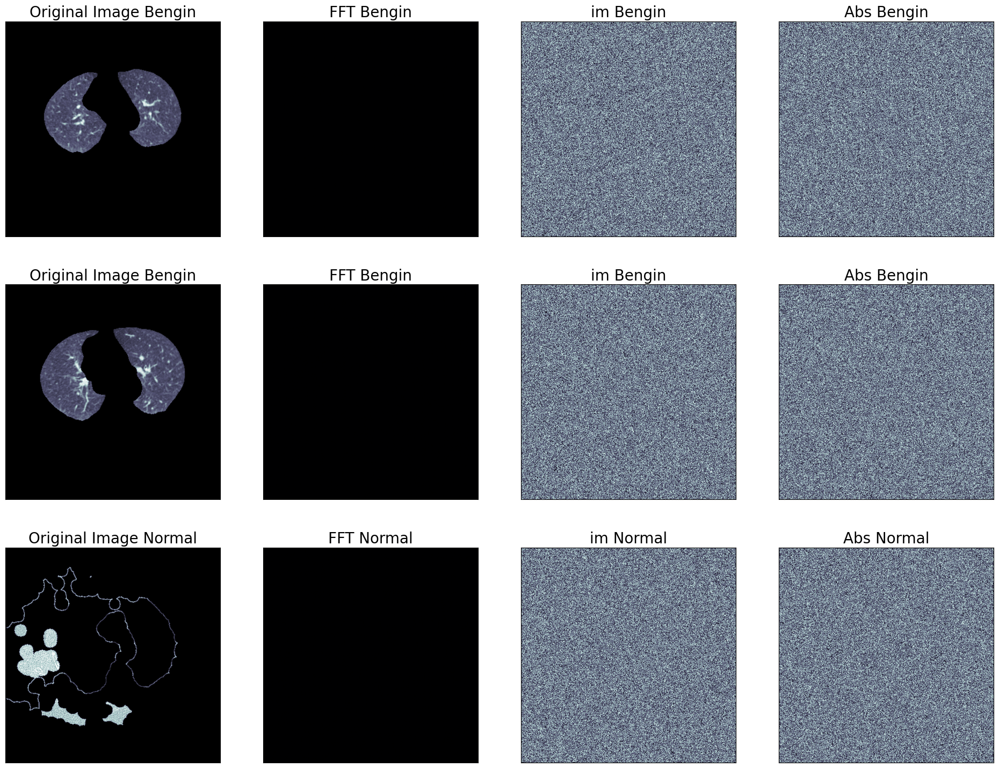

In [24]:
images = [X_segmented[0],np.fft.ifft2(X_segmented_fft[0]).real, X_segmented_fft_imaginer[0], X_segmented_fft_abs[0], 
          X_segmented[15], np.fft.ifft2(X_segmented_fft[15]).real, X_segmented_fft_imaginer[15], X_segmented_fft_abs[15], 
          X_segmented[34], np.fft.ifft2(X_segmented_fft[34]).real, X_segmented_fft_imaginer[34], X_segmented_fft_abs[34]]
titles = ['Original Image ' + y[0], 'FFT ' + y[0], 'im ' + y[0], 'Abs ' + y[0],
         'Original Image ' + y[15], 'FFT ' + y[15], 'im ' + y[15],  'Abs ' + y[15],
         'Original Image ' + y[34], 'FFT ' + y[34], 'im ' + y[34], 'Abs ' + y[34]]
plot_img(images, titles, camp=plt.cm.bone, rows = 3, cols = 4, fontsize= 20, top=3, right=3)

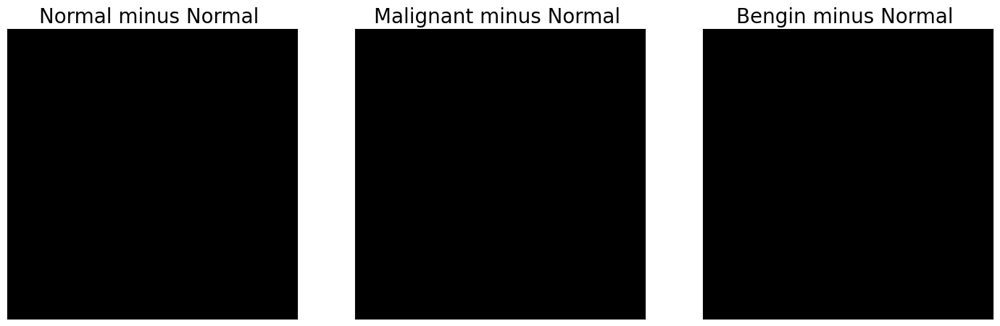

In [20]:
# substracting normal with desease

normal = [i for i, x in enumerate(y) if x == "Normal"]
malignant = [i for i, x in enumerate(y) if x == "Malignant"]
bengin = [i for i, x in enumerate(y) if x == "Bengin"]

normal_min_normal = np.empty((1, IMG_SIZE, IMG_SIZE), dtype=np.uint8)
malignant_min_normal = np.empty((1, IMG_SIZE, IMG_SIZE), dtype=np.uint8)
bengin_min_normal = np.empty((1, IMG_SIZE, IMG_SIZE), dtype=np.uint8)

X_segmented_fft_normal = X_segmented_fft[1]
X_nodules_fft_normal = X_nodules_fft[1]
X_nodules_further_fft_normal = X_nodules_further_fft[1]
X_nodules_opening_fft_normal = X_nodules_opening_fft[1]

X_segmented_fft_malignant = X_segmented_fft[6]
X_nodules_fft_malignant = X_nodules_fft[6]
X_nodules_further_fft_malignant = X_nodules_further_fft[6]
X_nodules_opening_fft_malignant = X_nodules_opening_fft[6]

X_segmented_fft_bengin = X_segmented_fft[5]
X_nodules_fft_bengin = X_nodules_fft[5]
X_nodules_further_fft_bengin = X_nodules_further_fft[5]
X_nodules_opening_fft_bengin = X_nodules_opening_fft[5]

normal_min_normal[0] = X_segmented_fft_normal-X_segmented_fft_normal
malignant_min_normal[0] = X_segmented_fft_malignant-X_segmented_fft_normal
bengin_min_normal[0] = X_segmented_fft_bengin - X_segmented_fft_normal

#Melakukan IFFT
normal_min_normal[0] = np.fft.ifft2(normal_min_normal[0])
malignant_min_normal[0] = np.fft.ifft2(malignant_min_normal[0])
bengin_min_normal[0] = np.fft.ifft2(bengin_min_normal[0])



images = [normal_min_normal[0], malignant_min_normal[0],bengin_min_normal[0]]
titles = ['Normal minus Normal ' , 'Malignant minus Normal ', 'Bengin minus Normal ']
plot_img(images, titles, camp=plt.cm.bone, rows = 3, cols = 4, fontsize= 20, top=3, right=3)


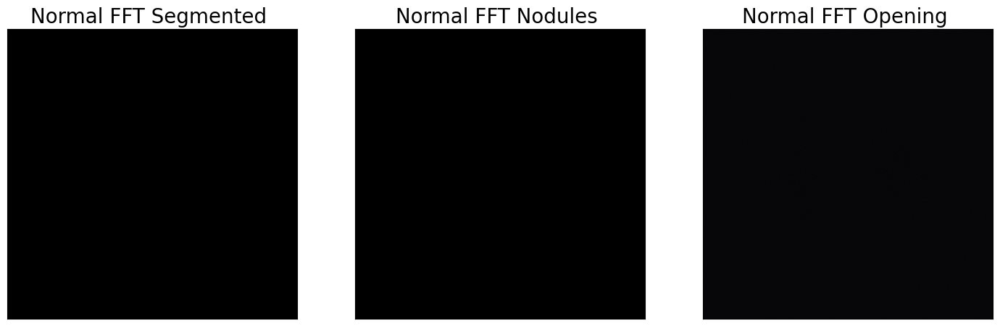

In [21]:
# substracting normal with desease

normal = [i for i, x in enumerate(y) if x == "Normal"]
malignant = [i for i, x in enumerate(y) if x == "Malignant"]
bengin = [i for i, x in enumerate(y) if x == "Bengin"]


X_segmented_fft_normal = np.fft.ifft2(X_segmented_fft[1]).real
X_nodules_fft_normal = np.fft.ifft2(X_nodules_fft[1]).real
X_nodules_further_fft_normal = np.fft.ifft2(X_nodules_further_fft[1]).real
X_nodules_opening_fft_normal = np.fft.ifft2(X_nodules_opening_fft[1]).real


images = [X_segmented_fft_normal, X_nodules_fft_normal,X_nodules_opening_fft_normal]
titles = ['Normal FFT Segmented ' , 'Normal FFT Nodules ', 'Normal FFT Opening ']
plot_img(images, titles, camp=plt.cm.bone, rows = 3, cols = 4, fontsize= 20, top=3, right=3)


In [35]:
print(pd.Series(y).factorize())

(array([0, 0, 0, 0, 1, 1, 1, 1, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2],
      dtype=int64), Index(['Bengin', 'Malignant', 'Normal'], dtype='object'))


In [30]:
r_rscv = y.copy()

y_rscv = pd.Series(r_rscv)

y_rscv = r_rscv.factorize()


To convert the `y` array to categorical values using `tf.keras.utils.to_categorical`, you can use the following code:

```python
from tensorflow.keras.utils import to_categorical

# Convert y to one-hot encoding
y_categorical = to_categorical(y)
```

This will convert the `y` array into a one-hot encoded representation where each row represents a sample and each column represents a class. The number of columns in the resulting array will be equal to the number of unique classes in the `y` array.

In [39]:
from tensorflow.keras.utils import to_categorical

# Convert y to one-hot encoding
y_categorical = to_categorical(y_rscv[0])

In [41]:
print (y_categorical)

[[1. 0. 0.]
 [1. 0. 0.]
 [1. 0. 0.]
 [1. 0. 0.]
 [0. 1. 0.]
 [0. 1. 0.]
 [0. 1. 0.]
 [0. 1. 0.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [1. 0. 0.]
 [1. 0. 0.]
 [1. 0. 0.]
 [1. 0. 0.]
 [1. 0. 0.]
 [1. 0. 0.]
 [1. 0. 0.]
 [1. 0. 0.]
 [1. 0. 0.]
 [1. 0. 0.]
 [0. 1. 0.]
 [0. 1. 0.]
 [0. 1. 0.]
 [0. 1. 0.]
 [0. 1. 0.]
 [0. 1. 0.]
 [0. 1. 0.]
 [0. 1. 0.]
 [0. 1. 0.]
 [0. 1. 0.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]]


In [42]:
import tensorflow as tf
from tensorflow.keras import layers

# Define RNN model
model = tf.keras.Sequential([
    layers.LSTM(64),
    layers.Dense(3, activation='softmax')
])

# Compile model
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Train model
X_segmented_fft = tf.cast(X_segmented_fft,tf.float32)
model.fit(X_segmented_fft, y_categorical, epochs=10)

# Evaluate model
model.evaluate(X_segmented_fft, y_categorical)


Epoch 1/10
2/2 [==============================] - 3s 280ms/step - loss: 1.2552 - accuracy: 0.3810
Epoch 2/10
2/2 [==============================] - 1s 328ms/step - loss: 1.2958 - accuracy: 0.2619
Epoch 3/10
2/2 [==============================] - 1s 369ms/step - loss: 1.1789 - accuracy: 0.2619
Epoch 4/10
2/2 [==============================] - 1s 303ms/step - loss: 1.1024 - accuracy: 0.4524
Epoch 5/10
2/2 [==============================] - 1s 362ms/step - loss: 1.1158 - accuracy: 0.4524
Epoch 6/10
2/2 [==============================] - 1s 332ms/step - loss: 1.0723 - accuracy: 0.4762
Epoch 7/10
2/2 [==============================] - 1s 303ms/step - loss: 1.0702 - accuracy: 0.4762
Epoch 8/10
2/2 [==============================] - 1s 265ms/step - loss: 1.0533 - accuracy: 0.5000
Epoch 9/10
2/2 [==============================] - 1s 256ms/step - loss: 1.0165 - accuracy: 0.5000
Epoch 10/10
2/2 [==============================] - 1s 96ms/step - loss: 1.0849 - accuracy: 0.3095


[1.0849213600158691, 0.3095238208770752]

The results `[1.0849213600158691, 0.3095238208770752]` are the values of the loss and accuracy metrics calculated by the `evaluate` method of the model on the given data.

The first value `1.0849213600158691` is the value of the loss function, which in this case is `categorical_crossentropy`. This value represents how well the model's predictions match the true labels on the given data. A lower value for the loss function indicates better performance of the model.

The second value `0.3095238208770752` is the value of the accuracy metric. This value represents the fraction of correctly classified samples in the given data. In this case, an accuracy of `0.3095238208770752` means that about 31% of the samples were correctly classified by the model.

These results provide a quantitative measure of how well the trained model performs on the given data.

The loss is a measure of how well the model's predictions match the true labels of the data. It is calculated using a loss function, which in this case is `categorical_crossentropy`. The loss function takes as input the predicted probabilities for each class and the true labels, and calculates a scalar value that represents how well the predictions match the true labels.

A lower value for the loss indicates better performance of the model, as it means that the model's predictions are closer to the true labels. During training, the goal is to minimize the value of the loss function by adjusting the model's parameters.

There is no fixed baseline value for the loss, as it depends on the specific problem and data. However, one way to establish a baseline is to calculate the loss of a naive model that always predicts the most frequent class in the data. This will give you an idea of how well a simple model performs on your data, and you can compare your trained model's performance to this baseline.